## A1 - Cell Level Aggregation from PASTA Results

This notebook demonstrates how to aggregate PASTA pixel-level predictions to cell-level results, including:
- **Gene expression aggregation**: Average gene expression scores within each cell
- **Cell type assignment**: Assign cell type labels by aggregating pathway predcitions to cellular resolution

The workflow integrates cell segmentation boundaries with PASTA's pixel-level predictions to create spatial maps that reveal heterogeneity within tissue microenvironments.

**Example Dataset**: [Xenium Breast data](https://www.10xgenomics.com/products/xenium-in-situ/human-breast-dataset-explorer) (HEST ID: NCBI785)

### 1. Load cell segmentation results

Cell segmentation results can be obtained from:
- Running [CellViT](https://github.com/TIO-IKIM/CellViT) or [Hovernet](https://github.com/vqdang/hover_net) on H&E images
- Downloading precomputed results from the official Xenium dataset

The segmentation should be in GeoJSON format with cell polygons.

In [ ]:
import json
import os
import glob
import warnings
import openslide
from typing import List, Dict, Tuple, Optional
import numpy as np
import pandas as pd
import cv2
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from tqdm import tqdm
import anndata as ad

warnings.filterwarnings('ignore')

#### 1.1 Load cell segmentation file

We'll load the cell segmentation GeoJSON file and parse the cell polygons.

In [ ]:
# Specify the path to your cell segmentation GeoJSON file
geojson_path = '/workspace/data/Xenium_breast/NCBI785_xenium_nucleus_seg.geojson'

print(f"Loading cell segmentation from:\n{geojson_path}")

Loading cell segmentation from:
/workspace/data/Xenium_breast/NCBI785_xenium_nucleus_seg.geojson


In [ ]:
def load_geojson_cells(geojson_path: str) -> List[Dict]:
    """
    Load and parse cell segmentation GeoJSON file to extract cell polygons and metadata.
    
    Args:
        geojson_path: Path to the GeoJSON file containing cell segmentations
        
    Returns:
        List of cell dictionaries with keys: cell_id, cell_type, polygon_coords, centroid
    """
    with open(geojson_path, 'r', encoding='utf-8') as f:
        geojson_data = json.load(f)
    
    cells = []
    
    # Handle different GeoJSON structures
    if isinstance(geojson_data, dict):
        if 'features' in geojson_data:
            features = geojson_data['features']
        elif 'type' in geojson_data and geojson_data['type'] == 'Feature':
            features = [geojson_data]
        else:
            features = [geojson_data]
    elif isinstance(geojson_data, list):
        features = geojson_data
    else:
        raise ValueError(f"Unexpected GeoJSON structure: {type(geojson_data)}")
    
    for feature_idx, feature in enumerate(features):
        if not isinstance(feature, dict):
            continue
            
        # Extract cell type from properties
        properties = feature.get('properties', {})
        cell_type = properties.get('classification', {}).get('name', 'Unknown')
        if cell_type == 'Unknown':
            cell_type = properties.get('type', f'Type_{feature_idx}')
        
        # Extract geometry
        geometry = feature.get('geometry', feature)
        geom_type = geometry.get('type', '')
        coordinates = geometry.get('coordinates', [])
        
        if not coordinates:
            continue
        
        # Handle MultiPolygon: each polygon is a separate cell
        if geom_type == 'MultiPolygon':
            for poly_idx, polygon_rings in enumerate(coordinates):
                if not polygon_rings or len(polygon_rings) == 0:
                    continue
                
                # Get exterior ring (first ring) as numpy array
                try:
                    exterior_ring = np.array(polygon_rings[0], dtype=np.float32)
                    
                    if len(exterior_ring) < 3:  # Need at least 3 points for a polygon
                        continue
                    
                    centroid_x = float(np.mean(exterior_ring[:, 0]))
                    centroid_y = float(np.mean(exterior_ring[:, 1]))
                    
                    cell_id = f"{cell_type}_{poly_idx}"
                    
                    cells.append({
                        'cell_id': cell_id,
                        'cell_type': cell_type,
                        'polygon_coords': exterior_ring,
                        'centroid': (centroid_x, centroid_y)
                    })
                except (ValueError, IndexError, TypeError) as e:
                    continue
        
        # Handle single Polygon
        elif geom_type == 'Polygon':
            if len(coordinates) > 0:
                try:
                    exterior_ring = np.array(coordinates[0], dtype=np.float32)
                    
                    if len(exterior_ring) >= 3:
                        centroid_x = float(np.mean(exterior_ring[:, 0]))
                        centroid_y = float(np.mean(exterior_ring[:, 1]))
                        
                        cell_id = feature.get('id', f'{cell_type}_0')
                        
                        cells.append({
                            'cell_id': cell_id,
                            'cell_type': cell_type,
                            'polygon_coords': exterior_ring,
                            'centroid': (centroid_x, centroid_y)
                        })
                except (ValueError, IndexError, TypeError) as e:
                    continue
    
    return cells

In [ ]:
# Load cell segmentation from GeoJSON file
cells = load_geojson_cells(geojson_path)

print(f"\n✓ Successfully loaded {len(cells):,} cells from GeoJSON file")


✓ Successfully loaded 167,780 cells from GeoJSON file


#### 1.2 Examine cell data structure

Let's look at the structure of the loaded cell data and count cells by type.

In [ ]:
# Examine the structure of the first cell
print("📋 Example cell structure:")
print("-" * 50)
example_cell = cells[0]
for key, value in example_cell.items():
    if key == 'polygon_coords':
        print(f"  {key}: numpy array with shape {value.shape}")
        print(f"    - First 3 points: {value[:3].tolist()}")
    else:
        print(f"  {key}: {value}")

📋 Example cell structure:
--------------------------------------------------
  cell_id: 0_0
  cell_type: 0
  polygon_coords: numpy array with shape (13, 2)
    - First 3 points: [[8289.6298828125, 20876.7890625], [8286.140625, 20873.853515625], [8285.5751953125, 20869.763671875]]
  centroid: (8293.439453125, 20868.990234375)


In [ ]:
# Count cells by type
cell_types = {}
for cell in cells:
    ct = cell['cell_type']
    cell_types[ct] = cell_types.get(ct, 0) + 1

print("\n📊 Cell type distribution:")
print("-" * 50)
for ct, count in sorted(cell_types.items()):
    print(f"  Type {ct}: {count:,} cells ({100*count/len(cells):.1f}%)")


📊 Cell type distribution:
--------------------------------------------------
  Type 0: 16,779 cells (10.0%)
  Type 1: 16,779 cells (10.0%)
  Type 2: 16,779 cells (10.0%)
  Type 3: 16,779 cells (10.0%)
  Type 4: 16,779 cells (10.0%)
  Type 5: 16,779 cells (10.0%)
  Type 6: 16,779 cells (10.0%)
  Type 7: 16,779 cells (10.0%)
  Type 8: 16,779 cells (10.0%)
  Type 9: 16,769 cells (10.0%)


#### 1.3 Visualize cell spatial distribution

Visualize the spatial distribution of cell centroids to verify the segmentation coverage.

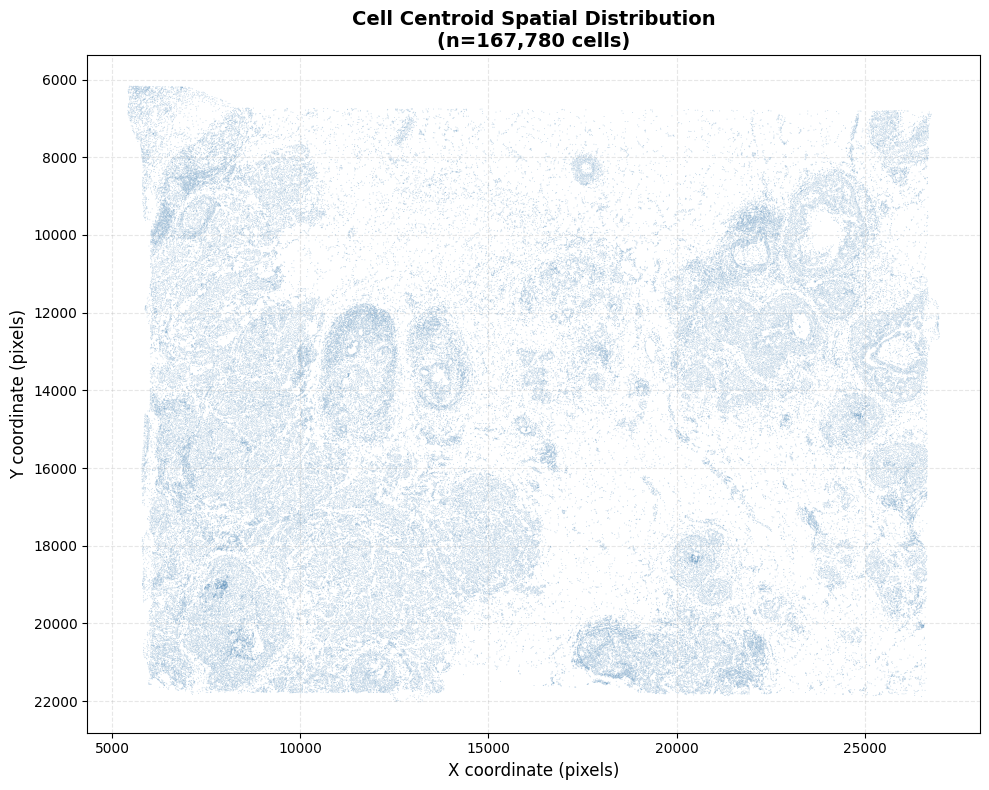


📍 Spatial extent:
  X range: [5422, 26985] pixels
  Y range: [6168, 22020] pixels


In [ ]:
# Extract cell centroids
centroids = np.array([cell['centroid'] for cell in cells])

# Create visualization
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
ax.scatter(centroids[:, 0], centroids[:, 1], s=0.5, alpha=0.3, c='steelblue', edgecolors='none')
ax.set_xlabel('X coordinate (pixels)', fontsize=12)
ax.set_ylabel('Y coordinate (pixels)', fontsize=12)
ax.set_title(f'Cell Centroid Spatial Distribution\n(n={len(cells):,} cells)', fontsize=14, fontweight='bold')
ax.invert_yaxis()  # Match image coordinates (origin at top-left)
ax.grid(True, alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

# Print spatial extent
print(f"\n📍 Spatial extent:")
print(f"  X range: [{centroids[:, 0].min():.0f}, {centroids[:, 0].max():.0f}] pixels")
print(f"  Y range: [{centroids[:, 1].min():.0f}, {centroids[:, 1].max():.0f}] pixels")

### 2. Aggregate gene expression to cell level

Now we'll load PASTA prediction results and calculate average gene expression for each cell by aggregating pixel-level predictions within cell boundaries.

#### 2.1 Load tissue boundary information

We need to load the tissue boundary information to properly align cell coordinates with PASTA predictions.

In [ ]:
# Load the edge information to get tissue boundaries
# This is needed to align cell coordinates with PASTA predictions
edge_info_path = '/workspace/results/NCBI785/edge_info/NCBI785.json'

with open(edge_info_path, 'r') as f:
    edge_info = json.load(f)

min_x = edge_info['min_x']
min_y = edge_info['min_y']

print(f"📍 Tissue boundaries:")
print(f"  min_x: {min_x:,} pixels")
print(f"  min_y: {min_y:,} pixels")
print(f"\nThese coordinates define the top-left corner of the tissue region.")

📍 Tissue boundaries:
  min_x: 2,528 pixels
  min_y: 2,145 pixels

These coordinates define the top-left corner of the tissue region.


#### 2.2 Define helper functions for aggregation

We'll define functions to:
1. Load pathway predictions from NPZ files
2. Calculate cell-level scores by averaging within cell boundaries
3. Save results in CSV and H5AD formats
4. Visualize cell-level scores spatially

In [ ]:
def load_pathway_predictions(npz_dir: str, downsample_size: int = 10) -> Tuple[Dict[str, np.ndarray], List[str]]:
    """
    Load pathway prediction NPZ files from inference output directory.
    
    Args:
        npz_dir: Directory containing NPZ files from PASTA inference
        downsample_size: Downsample factor used during inference
        
    Returns:
        Tuple of (pathway_arrays dict, pathway_names list)
    """
    print(f"Loading PASTA predictions from:\n{npz_dir}\n")
    
    # Try with downsample suffix first
    npz_files = sorted(glob.glob(f"{npz_dir}/*_downsample_{downsample_size}.npz"))
    
    # Fall back to all NPZ files if none found
    if len(npz_files) == 0:
        npz_files = sorted(glob.glob(f"{npz_dir}/*.npz"))
    
    if len(npz_files) == 0:
        raise ValueError(f"No NPZ files found in {npz_dir}")
    
    pathway_arrays = {}
    pathway_names = []
    
    for npz_file in npz_files:
        # Extract pathway name from filename
        basename = os.path.basename(npz_file)
        pathway_name = basename.replace(f'_downsample_{downsample_size}.npz', '').replace('.npz', '')
        
        # Load array
        data = np.load(npz_file)['data']
        pathway_arrays[pathway_name] = data
        pathway_names.append(pathway_name)
        
        print(f"  Loaded {pathway_name}: shape {data.shape}")
    
    print(f"Loaded {len(pathway_names)} pathway predictions")
    return pathway_arrays, pathway_names

In [ ]:
def calculate_cell_scores(cells: List[Dict], 
                         pathway_arrays: Dict[str, np.ndarray],
                         downsample_size: int = 10,
                         min_x: int = 0,
                         min_y: int = 0,
                         blank: int = 3000) -> pd.DataFrame:
    """
    Calculate average pathway scores for each cell region.
    
    Args:
        cells: List of cell dictionaries from load_geojson_cells
        pathway_arrays: Dictionary of pathway name -> score array
        downsample_size: Downsample factor used during inference
        min_x: Minimum x coordinate from original tissue (for offset calculation)
        min_y: Minimum y coordinate from original tissue (for offset calculation)
        blank: Blank space added around tissue during inference
        
    Returns:
        DataFrame with cell scores
    """
    print(f"Calculating cell-level scores for {len(cells)} cells...")
    
    # Get array dimensions from first pathway
    first_pathway = list(pathway_arrays.keys())[0]
    array_shape = pathway_arrays[first_pathway].shape
    height, width = array_shape
    
    # Calculate offset (coordinates in GeoJSON are in original WSI space)
    # During inference: x_origin = min_x - blank//2
    x_origin = min_x - blank // 2
    y_origin = min_y - blank // 2
    
    results = []
    
    for cell in tqdm(cells, desc="Processing cells"):
        cell_id = cell['cell_id']
        cell_type = cell['cell_type']
        polygon_coords = cell['polygon_coords']
        centroid_x, centroid_y = cell['centroid']
        
        # Get polygon bounds
        minx = float(np.min(polygon_coords[:, 0]))
        miny = float(np.min(polygon_coords[:, 1]))
        maxx = float(np.max(polygon_coords[:, 0]))
        maxy = float(np.max(polygon_coords[:, 1]))
        
        # Convert to downsampled coordinates
        minx_ds = int((minx - x_origin) / downsample_size)
        miny_ds = int((miny - y_origin) / downsample_size)
        maxx_ds = int((maxx - x_origin) / downsample_size)
        maxy_ds = int((maxy - y_origin) / downsample_size)
        
        # Ensure bounds are within array
        minx_ds = max(0, minx_ds)
        miny_ds = max(0, miny_ds)
        maxx_ds = min(width, maxx_ds)
        maxy_ds = min(height, maxy_ds)
        
        # Skip if cell is completely outside the array
        if minx_ds >= width or miny_ds >= height or maxx_ds <= 0 or maxy_ds <= 0:
            continue
        
        # Create mask for this cell in the bounding box
        bbox_width = maxx_ds - minx_ds
        bbox_height = maxy_ds - miny_ds
        
        if bbox_width <= 0 or bbox_height <= 0:
            continue
        
        # Create a mask for the cell polygon
        mask = np.zeros((bbox_height, bbox_width), dtype=np.uint8)
        
        # Convert polygon coordinates to downsampled space and adjust for bounding box
        exterior_coords_ds = (polygon_coords - [x_origin, y_origin]) / downsample_size
        exterior_coords_ds = exterior_coords_ds - [minx_ds, miny_ds]
        exterior_coords_ds = exterior_coords_ds.astype(np.int32)
        
        # Fill polygon
        cv2.fillPoly(mask, [exterior_coords_ds], 1)
        
        # Calculate mean scores for each pathway
        cell_scores = {
            'cell_id': cell_id,
            'cell_type': cell_type,
            'x_centroid': centroid_x,
            'y_centroid': centroid_y
        }
        
        for pathway_name, pathway_array in pathway_arrays.items():
            # Extract region
            region = pathway_array[miny_ds:maxy_ds, minx_ds:maxx_ds]
            
            # Apply mask and calculate mean
            if mask.shape == region.shape:
                masked_values = region[mask > 0]
                if len(masked_values) > 0:
                    cell_scores[f'{pathway_name}_mean'] = float(np.mean(masked_values))
                else:
                    cell_scores[f'{pathway_name}_mean'] = np.nan
            else:
                cell_scores[f'{pathway_name}_mean'] = np.nan
        
        results.append(cell_scores)
    
    df = pd.DataFrame(results)
    print(f"Calculated scores for {len(df)} cells")
    return df


def save_cell_scores_csv(cell_scores: pd.DataFrame, output_path: str):
    """
    Save cell scores to CSV format.
    
    Args:
        cell_scores: DataFrame with cell scores
        output_path: Output CSV file path
    """
    cell_scores.to_csv(output_path, index=False)
    print(f"Saved cell scores CSV to: {output_path}")


def save_cell_scores_h5ad(cell_scores: pd.DataFrame, 
                          pathway_names: List[str], 
                          output_path: str):
    """
    Create and save AnnData object with cell-level data.
    
    Args:
        cell_scores: DataFrame with cell scores
        pathway_names: List of pathway names
        output_path: Output H5AD file path
    """
    # Extract expression matrix (pathway scores)
    pathway_cols = [f'{name}_mean' for name in pathway_names]
    X = cell_scores[pathway_cols].values
    
    # Create obs (cell metadata)
    obs = cell_scores[['cell_id', 'cell_type', 'x_centroid', 'y_centroid']].copy()
    obs.index = cell_scores['cell_id'].astype(str)
    
    # Create var (pathway metadata)
    var = pd.DataFrame(index=pathway_names)
    
    # Create spatial coordinates
    spatial = cell_scores[['x_centroid', 'y_centroid']].values
    
    # Create AnnData object
    adata = ad.AnnData(X=X, obs=obs, var=var)
    adata.obsm['spatial'] = spatial
    
    # Save
    adata.write_h5ad(output_path)
    print(f"Saved cell scores H5AD to: {output_path}")


def visualize_cell_scores(cell_scores: pd.DataFrame,
                         pathway_names: List[str],
                         output_dir: str,
                         array_shape: Tuple[int, int],
                         downsample_size: int = 10,
                         min_x: int = 0,
                         min_y: int = 0,
                         blank: int = 3000,
                         figsize: int = 10,
                         cmap: str = 'turbo',
                         cells: Optional[List[Dict]] = None,
                         wsi_path: Optional[str] = None,
                         sample_id: Optional[str] = None,
                         file_type: str = '.svs',
                         create_overlay: bool = False):
    """
    Generate cell-colored pathway score visualizations.
    
    Args:
        cell_scores: DataFrame with cell scores
        pathway_names: List of pathway names
        output_dir: Directory to save plots
        array_shape: Shape of the pathway arrays (height, width)
        downsample_size: Downsample factor
        min_x: Minimum x coordinate from original tissue
        min_y: Minimum y coordinate from original tissue
        blank: Blank space added around tissue
        figsize: Figure size
        cmap: Colormap name
        cells: Original cell list with polygon geometries
        wsi_path: Path to WSI directory (required if create_overlay=True)
        sample_id: Sample ID (required if create_overlay=True)
        file_type: WSI file extension (default: '.svs')
        create_overlay: Whether to create overlay images on HE background
    """
    os.makedirs(output_dir, exist_ok=True)
    print(f"Generating visualizations in: {output_dir}")
    
    if cells is None:
        print("Warning: No cell geometries provided, skipping visualization")
        return
    
    height, width = array_shape
    x_origin = min_x - blank // 2
    y_origin = min_y - blank // 2
    
    # Load HE image if overlay is requested
    he_image = None
    gray_image = None
    if create_overlay:
        if wsi_path is None or sample_id is None:
            print("Warning: wsi_path and sample_id required for overlay, skipping overlay generation")
            create_overlay = False
        else:
            try:
                slide = openslide.open_slide(f"{wsi_path}/{sample_id}{file_type}")
                
                w_origin = width * downsample_size
                h_origin = height * downsample_size
                level = slide.get_best_level_for_downsample(downsample_size)
                factor = slide.level_downsamples[level]
                w_lv, h_lv = int(w_origin / factor), int(h_origin / factor)
                
                thumb = slide.read_region((x_origin, y_origin), level, (w_lv, h_lv)).convert("RGB")
                thumb = thumb.resize((width, height))
                he_image = np.array(thumb)
                gray_image = cv2.cvtColor(he_image, cv2.COLOR_RGB2GRAY)
                
                print(f"Loaded HE image for overlay: {he_image.shape}")
                
                # Create overlay output directory
                overlay_dir = os.path.join(os.path.dirname(output_dir), 'cell_plots_overlay')
                os.makedirs(overlay_dir, exist_ok=True)
            except Exception as e:
                print(f"Warning: Failed to load HE image: {e}")
                create_overlay = False
    
    # Create a mapping from cell_id to scores
    cell_score_dict = cell_scores.set_index('cell_id').to_dict('index')
    
    for pathway_name in tqdm(pathway_names, desc="Creating visualizations"):
        # Create blank image
        cell_image = np.full((height, width), np.nan, dtype=np.float32)
        
        # Fill each cell with its average score
        for cell in cells:
            cell_id = cell['cell_id']
            
            if cell_id not in cell_score_dict:
                continue
            
            score = cell_score_dict[cell_id].get(f'{pathway_name}_mean', np.nan)
            
            if np.isnan(score):
                continue
            
            polygon_coords = cell['polygon_coords']
            
            # Get polygon bounds
            minx = float(np.min(polygon_coords[:, 0]))
            miny = float(np.min(polygon_coords[:, 1]))
            maxx = float(np.max(polygon_coords[:, 0]))
            maxy = float(np.max(polygon_coords[:, 1]))
            
            # Convert to downsampled coordinates
            minx_ds = int((minx - x_origin) / downsample_size)
            miny_ds = int((miny - y_origin) / downsample_size)
            maxx_ds = int((maxx - x_origin) / downsample_size)
            maxy_ds = int((maxy - y_origin) / downsample_size)
            
            # Ensure bounds are within array
            minx_ds = max(0, minx_ds)
            miny_ds = max(0, miny_ds)
            maxx_ds = min(width, maxx_ds)
            maxy_ds = min(height, maxy_ds)
            
            if minx_ds >= width or miny_ds >= height or maxx_ds <= 0 or maxy_ds <= 0:
                continue
            
            bbox_width = maxx_ds - minx_ds
            bbox_height = maxy_ds - miny_ds
            
            if bbox_width <= 0 or bbox_height <= 0:
                continue
            
            # Create mask
            mask = np.zeros((bbox_height, bbox_width), dtype=np.uint8)
            exterior_coords_ds = (polygon_coords - [x_origin, y_origin]) / downsample_size
            exterior_coords_ds = exterior_coords_ds - [minx_ds, miny_ds]
            exterior_coords_ds = exterior_coords_ds.astype(np.int32)
            cv2.fillPoly(mask, [exterior_coords_ds], 1)
            
            # Fill cell region with score
            cell_image[miny_ds:maxy_ds, minx_ds:maxx_ds][mask > 0] = score
        
        # Create visualization
        plt.switch_backend('inline')
        plt.figure(figsize=(figsize, figsize), dpi=1200)
        plt.axis('off')
        
        # Calculate percentile-based normalization
        valid_scores = cell_image[~np.isnan(cell_image)]
        if len(valid_scores) > 0:
            vmin, vmax = np.percentile(valid_scores, (10, 98))
        else:
            vmin, vmax = 0, 1
        
        # Use bilinear interpolation for smoother visualization (especially for low downsample_size)
        plt.imshow(cell_image, cmap=cmap, interpolation='bilinear', vmin=vmin+0.8, vmax=vmax+0.75)
        plt.colorbar(label='Average Score', shrink=0.8)
        
        output_path = os.path.join(output_dir, f'{pathway_name.replace("/", "_")}_cells.png')
        print(f'Saved {output_path}')
        plt.savefig(output_path, bbox_inches='tight', dpi=1200)
        plt.show()
        plt.close()
        
        # Create overlay visualization if requested
        if create_overlay and he_image is not None:
            plt.figure(figsize=(figsize, figsize), dpi=600)
            plt.imshow(gray_image, cmap='gray', interpolation='bilinear')
            plt.imshow(cell_image, cmap=cmap, interpolation='bilinear', 
                      vmin=vmin, vmax=vmax, alpha=0.5)
            plt.axis('off')
            plt.tight_layout()
            
            overlay_path = os.path.join(overlay_dir, f'{pathway_name.replace("/", "_")}_cells_overlay.png')
            print(f'Saved {overlay_path}')
            
            plt.savefig(overlay_path, bbox_inches='tight', dpi=600)
            plt.close()
    
    print(f"Saved {len(pathway_names)} cell visualization plots")
    if create_overlay and he_image is not None:
        print(f"Saved {len(pathway_names)} overlay plots to {overlay_dir}")

#### 2.3 Load PASTA prediction results

Load the pathway prediction NPZ files generated by PASTA inference.

In [ ]:
# Specify paths to PASTA prediction results
npz_dir = '/workspace/results/NCBI785/predictions_rep_genes/'
downsample_size = 2  # The downsample factor used during PASTA inference

# Load pathway predictions
pathway_arrays, pathway_names = load_pathway_predictions(npz_dir, downsample_size)

print(f"\n✓ Successfully loaded {len(pathway_names)} predictions")

Loading PASTA predictions from:
/workspace/results/NCBI785/predictions_rep_genes/

Loading pathway predictions from: /workspace/results/NCBI785/predictions_rep_genes/
  Loaded CD3E: shape (11740, 14748)
  Loaded EGFR: shape (11740, 14748)
  Loaded ERBB2: shape (11740, 14748)
Loaded 3 pathway predictions

✓ Successfully loaded 3 pathway predictions


In [ ]:
# Display pathway information
print("\n📊 Loaded pathways:")
print("-" * 70)
for i, (name, array) in enumerate(zip(pathway_names, pathway_arrays.values()), 1):
    print(f"{i:2d}. {name:30s} - Shape: {array.shape}, Range: [{array.min():.3f}, {array.max():.3f}]")


📊 Loaded pathways:
----------------------------------------------------------------------
 1. CD3E                           - Shape: (11740, 14748), Range: [-0.597, 1.742]
 2. EGFR                           - Shape: (11740, 14748), Range: [-1.058, 4.281]
 3. ERBB2                          - Shape: (11740, 14748), Range: [-1.059, 8.766]


In [ ]:
# Visualize one example pathway prediction
example_pathway = pathway_names[0]
example_array = pathway_arrays[example_pathway]

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
im = ax.imshow(example_array, cmap='viridis', interpolation='bilinear')
ax.set_title(f'Example Pathway Prediction: {example_pathway}', fontsize=14, fontweight='bold')
ax.set_xlabel('X coordinate', fontsize=12)
ax.set_ylabel('Y coordinate', fontsize=12)
plt.colorbar(im, ax=ax, label='Prediction Score', shrink=0.8)
plt.tight_layout()
plt.show()

print(f"This shows the pixel-level prediction scores for '{example_pathway}'.")

#### 2.4 Calculate cell-level scores

Now we'll aggregate the pixel-level predictions to cell level by calculating the mean score within each cell boundary.

In [ ]:
# Calculate cell-level scores
blank = 3000  # Blank space added around tissue during inference

print("Calculating cell-level scores...")
print("This may take a few minutes depending on the number of cells.\n")

cell_scores = calculate_cell_scores(
    cells=cells,
    pathway_arrays=pathway_arrays,
    downsample_size=downsample_size,
    min_x=min_x,
    min_y=min_y,
    blank=blank
)

print(f"\n✓ Calculated scores for {len(cell_scores):,} cells")

Calculating cell-level scores...
This may take a few minutes depending on the number of cells.

Calculating cell-level scores for 167780 cells...


Processing cells: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 167780/167780 [00:18<00:00, 9319.80it/s]


Calculated scores for 167777 cells

✓ Calculated scores for 167,777 cells


In [ ]:
# Display the first few rows of the cell scores dataframe
print("📋 Cell scores dataframe preview:")
print("-" * 100)
print(cell_scores.head(10))

print(f"\n📊 Dataframe shape: {cell_scores.shape[0]:,} cells × {cell_scores.shape[1]} columns")

📋 Cell scores dataframe preview:
----------------------------------------------------------------------------------------------------
  cell_id cell_type   x_centroid    y_centroid  CD3E_mean  EGFR_mean  \
0     0_0         0  8293.439453  20868.990234   0.539062   1.089844   
1     0_1         0  8236.180664  20863.345703   0.441406   0.970215   
2     0_2         0  8299.588867  20858.371094   0.529297   1.123047   
3     0_3         0  8232.954102  20856.195312   0.449219   1.043945   
4     0_4         0  8284.821289  20858.035156   0.479248   1.085938   
5     0_5         0  8300.071289  20849.253906   0.495850   1.152344   
6     0_6         0  8259.477539  20838.544922   0.386719   0.796875   
7     0_7         0  8248.177734  20833.058594   0.376221   0.613281   
8     0_8         0  8300.373047  20822.970703   0.276855   0.598145   
9     0_9         0  8273.270508  20819.531250   0.315430   0.792969   

   ERBB2_mean  
0    5.406250  
1    5.742188  
2    5.132812  
3    5.48

In [ ]:
# Check for missing values
pathway_cols = [f'{name}_mean' for name in pathway_names]
missing_counts = cell_scores[pathway_cols].isna().sum()

print("\n🔍 Missing value analysis:")
print("-" * 70)
if missing_counts.sum() == 0:
    print("  ✓ No missing values detected - all cells have complete pathway scores")
else:
    print(f"  ⚠ Found missing values in {(missing_counts > 0).sum()} pathways:")
    for pathway, count in missing_counts[missing_counts > 0].items():
        print(f"    - {pathway}: {count} cells ({100*count/len(cell_scores):.2f}%)")


🔍 Missing value analysis:
----------------------------------------------------------------------
  ✓ No missing values detected - all cells have complete pathway scores


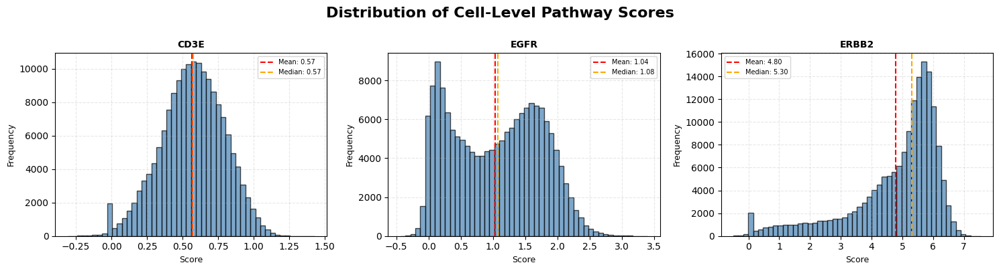

These histograms show the distribution of average pathway scores across all cells.


In [ ]:
# Visualize score distributions
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.flatten()

for idx, pathway in enumerate(pathway_names[:9]):  # Show first 9 pathways
    col = f'{pathway}_mean'
    scores = cell_scores[col].dropna()
    
    axes[idx].hist(scores, bins=50, color='steelblue', alpha=0.7, edgecolor='black')
    axes[idx].set_title(f'{pathway}', fontsize=10, fontweight='bold')
    axes[idx].set_xlabel('Score', fontsize=9)
    axes[idx].set_ylabel('Frequency', fontsize=9)
    axes[idx].grid(True, alpha=0.3, linestyle='--')
    
    # Add statistics
    mean_val = scores.mean()
    median_val = scores.median()
    axes[idx].axvline(mean_val, color='red', linestyle='--', linewidth=1.5, label=f'Mean: {mean_val:.2f}')
    axes[idx].axvline(median_val, color='orange', linestyle='--', linewidth=1.5, label=f'Median: {median_val:.2f}')
    axes[idx].legend(fontsize=7)

plt.suptitle('Distribution of Cell-Level Pathway Scores', fontsize=16, fontweight='bold', y=1.00)
plt.tight_layout()
plt.show()

print("These histograms show the distribution of average pathway scores across all cells.")

#### 2.5 Save cell-level results

Save the cell-level scores in CSV and H5AD formats for downstream analysis.

In [ ]:
# Define output directory
output_dir = '/workspace/results/NCBI785/analysis_cell_scoring/NCBI785'
os.makedirs(output_dir, exist_ok=True)

sample_id = 'NCBI785'

# Save as CSV
csv_path = os.path.join(output_dir, f'{sample_id}_cell_scores.csv')
save_cell_scores_csv(cell_scores, csv_path)

# Save as H5AD (AnnData format for single-cell analysis)
h5ad_path = os.path.join(output_dir, f'{sample_id}_cell_scores.h5ad')
save_cell_scores_h5ad(cell_scores, pathway_names, h5ad_path)

print(f"\n✓ Results saved to:\n  {output_dir}")

Saved cell scores CSV to: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/NCBI785_cell_scores.csv
Saved cell scores H5AD to: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/NCBI785_cell_scores.h5ad

✓ Results saved to:
  /workspace/results/NCBI785/analysis_cell_scoring/NCBI785


In [ ]:
# Verify the saved H5AD file
adata = ad.read_h5ad(h5ad_path)

print("📦 Loaded AnnData object:")
print("-" * 70)
print(f"  Shape: {adata.shape[0]:,} cells × {adata.shape[1]} pathways")
print(f"  Observations (cells): {list(adata.obs.columns)}")
print(f"  Variables (pathways): {list(adata.var.index[:5])} ... (showing first 5)")
print(f"  Spatial coordinates: {'spatial' in adata.obsm}")
print(f"\n  Expression matrix preview:")
print(adata.X[:5, :5])  # Show first 5x5 values

📦 Loaded AnnData object:
----------------------------------------------------------------------
  Shape: 167,777 cells × 3 pathways
  Observations (cells): ['cell_id', 'cell_type', 'x_centroid', 'y_centroid']
  Variables (pathways): ['CD3E', 'EGFR', 'ERBB2'] ... (showing first 5)
  Spatial coordinates: True

  Expression matrix preview:
[[0.5390625  1.08984375 5.40625   ]
 [0.44140625 0.97021484 5.7421875 ]
 [0.52929688 1.12304688 5.1328125 ]
 [0.44921875 1.04394531 5.484375  ]
 [0.47924805 1.0859375  4.98046875]]


#### 2.6 Visualize cell-level pathway scores

Create spatial visualizations showing pathway scores at the cell level.

Generating cell-level pathway visualizations...
This will create one plot per pathway.

Generating visualizations in: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_plots


Creating visualizations:   0%|                                                                                                               | 0/1 [00:00<?, ?it/s]

Saved /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_plots/ERBB2_cells.png


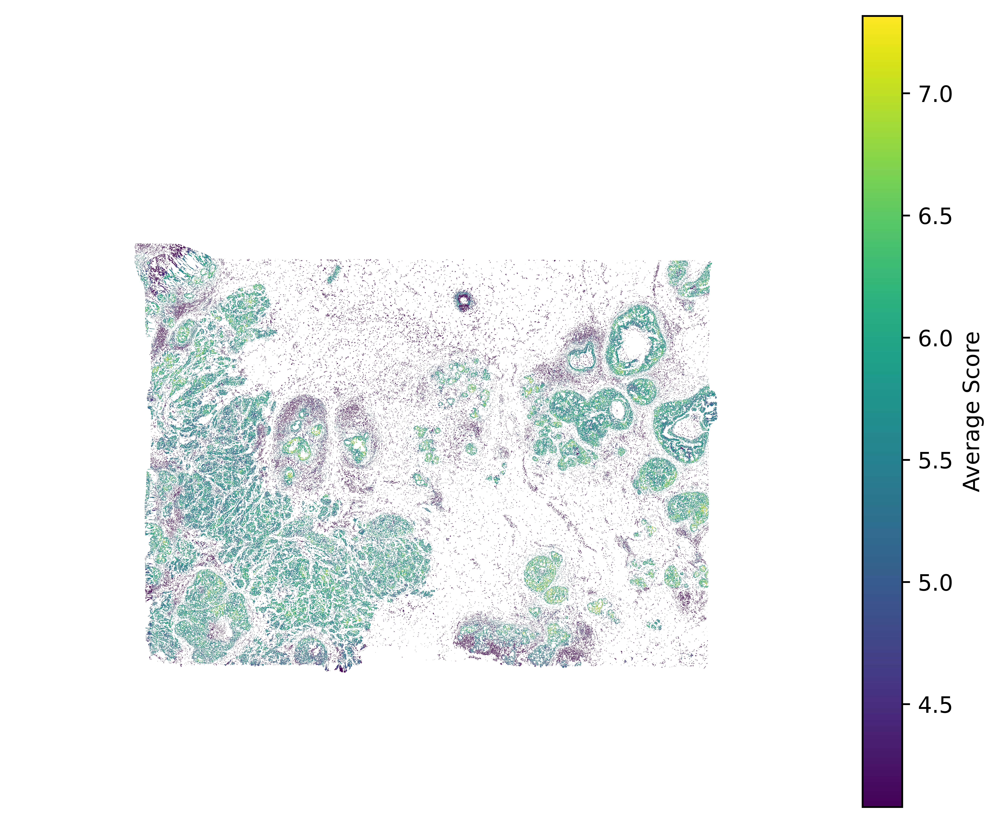

Creating visualizations: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:28<00:00, 88.66s/it]

Saved 1 cell visualization plots

✓ Visualizations saved to:
  /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_plots


In [ ]:
# Create cell-level visualizations
plot_dir = os.path.join(output_dir, 'cell_plots')
first_pathway = list(pathway_arrays.keys())[0]
array_shape = pathway_arrays[first_pathway].shape

print("Generating cell-level pathway visualizations...")
print("This will create one plot per pathway.\n")

visualize_cell_scores(
    cell_scores=cell_scores,
    pathway_names=['ERBB2'],  # Visualize first 3 pathways as examples
    output_dir=plot_dir,
    array_shape=array_shape,
    downsample_size=downsample_size,
    min_x=min_x,
    min_y=min_y,
    blank=blank,
    figsize=8,
    cmap='viridis',
    cells=cells,
    create_overlay=False
)

print(f"\n✓ Visualizations saved to:\n  {plot_dir}")

### 3. Cell type assignment based on pathway scores

In this section, we'll assign cell type labels based on the pathway scores using various methods.

#### 3.1 Cell labeling methods

We provide several methods for assigning cell type labels:

1. **Dominant**: Assign each cell the pathway with the highest z-score normalized score
2. **Threshold**: Assign pathways that exceed mean + std threshold
3. **Otsu**: Use Otsu's automatic thresholding for each pathway
4. **K-means**: Cluster cells based on pathway score profiles

Let's define the helper functions for cell labeling.

In [ ]:
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster
from skimage.filters import threshold_otsu
from sklearn.mixture import GaussianMixture

#### 3.1.1 Function: `assign_cell_labels`

This function assigns cell type labels based on pathway scores using various methods:

- **dominant**: Assigns the pathway with highest z-score
- **threshold**: Assigns pathways exceeding mean + std
- **kmeans**: Clusters cells based on pathway profiles
- **otsu**: Uses automatic Otsu thresholding for each pathway

In [ ]:
def assign_cell_labels(cell_scores: pd.DataFrame, 
                       pathway_names: List[str], 
                       method: str = 'otsu',
                       otsu_comparison: str = 'quantile',
                       threshold_multiplier: float = 1.0,
                       pathway_multipliers: Optional[Dict[str, float]] = None,
                       max_labels: int = 3,
                       threshold_comparison: str = 'quantile') -> pd.DataFrame:
    """
    Assign labels to cells based on pathway scores using various methods.
    Args:
        cell_scores: DataFrame with cell scores from calculate_cell_scores
        pathway_names: List of pathway names
        method: Labeling method - 'dominant', 'threshold', 'kmeans', or 'otsu'
        otsu_comparison: How to compare scores in otsu method when multiple pathways exceed threshold:
            - 'absolute': Use raw score values (original behavior, may favor high-scoring pathways)
            - 'relative': Use (score - threshold) / |threshold| for fair comparison
            - 'zscore': Use z-score normalized values for comparison
            - 'excess': Use (score - threshold) distance above threshold
            - 'quantile': Use quantile rank (0-1), higher is better - selects pathway where cell ranks highest (recommended)
        threshold_multiplier: Global multiplier for Otsu thresholds (>1 = stricter)
        pathway_multipliers: Per-pathway threshold multipliers, e.g., {'B-cells': 1.5}
        max_labels: Maximum number of labels to assign per cell (for 'threshold' and 'otsu' methods)
        threshold_comparison: Comparison method for 'threshold' mode ('zscore', 'quantile', or 'absolute')
        
    Returns:
        DataFrame with added 'label' column
    """
    print(f"Assigning cell labels using method: {method}")
    
    pathway_cols = [f'{name}_mean' for name in pathway_names]
    scores = cell_scores[pathway_cols].copy()
    scores = scores.fillna(0)
    
    if method == 'dominant':
        # Normalize
        scores_normalized = (scores - scores.mean()) / (scores.std() + 1e-10)
        
        labels = []
        for _, row in scores_normalized.iterrows():
            max_pathway_idx = row.values.argmax()
            labels.append(pathway_names[max_pathway_idx])
        cell_scores['label'] = labels
        
    elif method == 'threshold':
        scores_normalized = (scores - scores.mean()) / (scores.std() + 1e-10)
        if threshold_comparison == 'quantile':
            pathway_quantiles = {}
            for pathway, col in zip(pathway_names, pathway_cols):
                pathway_quantiles[pathway] = scores[col].rank(pct=True, method='average')
        
        print(f"Threshold comparison mode: {threshold_comparison}")
        print(f"Maximum labels per cell: {max_labels}")
        
        labels = []
        for idx, row in scores_normalized.iterrows():
            max_score = row.values.max()
            
            if max_score < 0:
                # All pathways are below their respective means - label as "Other"
                labels.append('Other')
            else:
                active_pathways = []
                for pathway_name, pathway_idx in zip(pathway_names, range(len(pathway_names))):
                    zscore = row.values[pathway_idx]
                    if zscore > 1.0:
                        if threshold_comparison == 'absolute':
                            comparison_score = scores.loc[idx, pathway_cols[pathway_idx]]
                        elif threshold_comparison == 'quantile':
                            comparison_score = pathway_quantiles[pathway_name].loc[idx]
                        else:
                            comparison_score = zscore
                        
                        active_pathways.append((pathway_name, comparison_score))
                
                if len(active_pathways) > 0:
                    active_pathways.sort(key=lambda x: x[1], reverse=True)
                    top_pathways = [p[0] for p in active_pathways[:max_labels]]
                    labels.append(','.join(top_pathways))
                else:
                    max_pathway_idx = row.values.argmax()
                    labels.append(pathway_names[max_pathway_idx])
        cell_scores['label'] = labels
        
    elif method == 'kmeans':
        k = min(len(pathway_names), len(scores)) 
        if k < 2:
            print(f"Warning: Not enough samples for k-means, using dominant method")
            return assign_cell_labels(cell_scores, pathway_names, 'dominant')
        
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(scores.values)
        cell_scores['label'] = [f'Cluster_{label_id}' for label_id in cluster_labels]
        
    elif method == 'otsu':
        # Otsu automatic thresholding - finds optimal threshold for each pathway
        print("Calculating Otsu thresholds for each pathway...")
        thresholds = calculate_otsu_thresholds(
            cell_scores, pathway_names, 
            threshold_multiplier=threshold_multiplier,
            pathway_multipliers=pathway_multipliers
        )
        
        print("Otsu thresholds:")
        for pathway, thresh in thresholds.items():
            pathway_col = f'{pathway}_mean'
            n_above = (scores[pathway_col] > thresh).sum()
            pct_above = 100 * n_above / len(scores)
            print(f"  {pathway}: {thresh:.4f} ({n_above} cells, {pct_above:.1f}% above threshold)")
        
        if otsu_comparison == 'zscore':
            scores_zscore = (scores - scores.mean()) / (scores.std() + 1e-10)
        
        if otsu_comparison == 'quantile':
            pathway_quantiles = {}
            for pathway, col in zip(pathway_names, pathway_cols):
                pathway_quantiles[pathway] = scores[col].rank(pct=True, method='average')
        
        print(f"Comparison mode: {otsu_comparison}")
        print(f"Maximum labels per cell: {max_labels}")
        
        labels = []
        for idx, row in scores.iterrows():
            active_pathways = []
            for pathway, col in zip(pathway_names, pathway_cols):
                score = row[col]
                thresh = thresholds[pathway]
                if score > thresh:
                    if otsu_comparison == 'absolute':
                        comparison_score = score
                    elif otsu_comparison == 'relative':
                        comparison_score = (score - thresh) / (abs(thresh) + 1e-10)
                    elif otsu_comparison == 'zscore':
                        comparison_score = scores_zscore.loc[idx, col]
                    elif otsu_comparison == 'excess':
                        comparison_score = score - thresh
                    elif otsu_comparison == 'quantile':
                        quantile_rank = pathway_quantiles[pathway].loc[idx]
                        comparison_score = quantile_rank
                    else:
                        comparison_score = score 
                    
                    active_pathways.append((pathway, comparison_score, score))
            
            if len(active_pathways) == 0:
                labels.append('Unknown')
            else:
                active_pathways.sort(key=lambda x: x[1], reverse=True)
                top_pathways = [p[0] for p in active_pathways[:max_labels]]
                labels.append(','.join(top_pathways))
        
        cell_scores['label'] = labels
        
    else:
        raise ValueError(f"Unknown labeling method: {method}")
    label_counts = cell_scores['label'].value_counts()
    print(f"Label distribution ({method}):")
    for label, count in label_counts.head(10).items():
        print(f"  {label}: {count} cells")
    if len(label_counts) > 10:
        print(f"  ... and {len(label_counts) - 10} more labels")
    
    return cell_scores


#### 3.1.2 Function: `visualize_cell_labels`

Creates spatial visualization of cells colored by their assigned labels.

In [ ]:
def visualize_cell_labels(cell_scores: pd.DataFrame,
                          method: str,
                          output_dir: str,
                          array_shape: Tuple[int, int],
                          downsample_size: int = 10,
                          min_x: int = 0,
                          min_y: int = 0,
                          blank: int = 3000,
                          figsize: int = 10,
                          cells: Optional[List[Dict]] = None):
    """
    Generate spatial visualization of cells colored by their assigned labels.
    
    Args:
        cell_scores: DataFrame with cell scores including 'label' column
        method: Labeling method name (for filename)
        output_dir: Directory to save plots
        array_shape: Shape of the pathway arrays (height, width)
        downsample_size: Downsample factor
        min_x: Minimum x coordinate from original tissue
        min_y: Minimum y coordinate from original tissue
        blank: Blank space added around tissue
        figsize: Figure size
        cells: Original cell list with polygon geometries
    """
    os.makedirs(output_dir, exist_ok=True)
    print(f"Generating label visualization for method: {method}")
    
    if cells is None:
        print("Warning: No cell geometries provided, skipping visualization")
        return
    if 'label' not in cell_scores.columns:
        print("Warning: No 'label' column found in cell_scores")
        return
    
    height, width = array_shape
    x_origin = min_x - blank // 2
    y_origin = min_y - blank // 2
    
    unique_labels = sorted(cell_scores['label'].unique())
    n_labels = len(unique_labels)
    
    cmap_colors = plt.cm.tab20.colors
    
    label_to_color = {label: cmap_colors[i % len(cmap_colors)] for i, label in enumerate(unique_labels)}
    cell_label_dict = cell_scores.set_index('cell_id')['label'].to_dict()
    label_image = np.zeros((height, width, 3), dtype=np.float32)
    mask_image = np.zeros((height, width), dtype=bool)
    for cell in tqdm(cells, desc="Rendering cells"):
        cell_id = cell['cell_id']
        
        if cell_id not in cell_label_dict:
            continue
        
        label = cell_label_dict[cell_id]
        color = label_to_color.get(label, (0.5, 0.5, 0.5))  # Gray for unknown
        
        polygon_coords = cell['polygon_coords']

        minx = float(np.min(polygon_coords[:, 0]))
        miny = float(np.min(polygon_coords[:, 1]))
        maxx = float(np.max(polygon_coords[:, 0]))
        maxy = float(np.max(polygon_coords[:, 1]))
        
        minx_ds = int((minx - x_origin) / downsample_size)
        miny_ds = int((miny - y_origin) / downsample_size)
        maxx_ds = int((maxx - x_origin) / downsample_size)
        maxy_ds = int((maxy - y_origin) / downsample_size)

        minx_ds = max(0, minx_ds)
        miny_ds = max(0, miny_ds)
        maxx_ds = min(width, maxx_ds)
        maxy_ds = min(height, maxy_ds)
        
        if minx_ds >= width or miny_ds >= height or maxx_ds <= 0 or maxy_ds <= 0:
            continue
        
        bbox_width = maxx_ds - minx_ds
        bbox_height = maxy_ds - miny_ds
        
        if bbox_width <= 0 or bbox_height <= 0:
            continue
        
        mask = np.zeros((bbox_height, bbox_width), dtype=np.uint8)
        exterior_coords_ds = (polygon_coords - [x_origin, y_origin]) / downsample_size
        exterior_coords_ds = exterior_coords_ds - [minx_ds, miny_ds]
        exterior_coords_ds = exterior_coords_ds.astype(np.int32)
        cv2.fillPoly(mask, [exterior_coords_ds], 1)
        
        for c in range(3):
            label_image[miny_ds:maxy_ds, minx_ds:maxx_ds, c][mask > 0] = color[c]
        mask_image[miny_ds:maxy_ds, minx_ds:maxx_ds][mask > 0] = True
    
    matplotlib.use('module://matplotlib_inline.backend_inline')
    fig, ax = plt.subplots(figsize=(figsize, figsize), dpi=300) 
    ax.axis('off')
    
    ax.imshow(label_image)
    
    label_counts = cell_scores['label'].value_counts()
    top_labels = label_counts.head(20).index.tolist()  

    legend_elements = []
    for label in top_labels:
        if label in label_to_color:
            color = label_to_color[label]
            count = label_counts[label]
            legend_elements.append(Patch(facecolor=color, label=f'{label} ({count})'))
    
    if len(label_counts) > 20:
        legend_elements.append(Patch(facecolor='white', edgecolor='black', 
                                     label=f'... and {len(label_counts)-20} more'))
    
    ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5),
              frameon=True, fontsize=8)
    
    
    ax.set_title(f'Cell Type Labels - {method.capitalize()} Method', 
                fontsize=8, fontweight='bold', pad=20)
    
    plt.tight_layout()
    
    output_path = os.path.join(output_dir, f'{method}_cell_labels.png')
    plt.savefig(output_path, bbox_inches='tight', dpi=600)
    print(f"Saved high-resolution visualization to: {output_path}")
    plt.show()
    
    print("\nCreating zoomed-in view of a representative region...")
    zoom_size = min(height, width) // 4  # 1/4 of the image size
    center_y, center_x = height // 2, width // 2
    y_start = max(0, center_y - zoom_size // 2)
    y_end = min(height, center_y + zoom_size // 2)
    x_start = max(0, center_x - zoom_size // 2)
    x_end = min(width, center_x + zoom_size // 2)
    
    zoomed_image = label_image[y_start:y_end, x_start:x_end]
    
    fig, ax = plt.subplots(figsize=(8, 8), dpi=300)
    ax.imshow(zoomed_image)
    ax.axis('off')
    ax.set_title(f'Zoomed View - {method.capitalize()} Method\n'
                f'Region: [{y_start}:{y_end}, {x_start}:{x_end}]',
                fontsize=8)
    
    plt.tight_layout()
    
    zoom_output_path = os.path.join(output_dir, f'{method}_cell_labels_zoom.png')
    plt.savefig(zoom_output_path, bbox_inches='tight', dpi=300)
    print(f"Saved zoomed visualization to: {zoom_output_path}")
    
    plt.show()
    plt.close('all')
    print(f"Saved label visualization to: {output_path}")

#### 3.1.3 Function: `calculate_otsu_thresholds`

Calculates optimal thresholds for each pathway using Otsu's method, which automatically finds the threshold that best separates foreground from background.

In [ ]:
def calculate_otsu_thresholds(cell_scores: pd.DataFrame, 
                             pathway_names: List[str],
                             threshold_multiplier: float = 1.0,
                             pathway_multipliers: Optional[Dict[str, float]] = None) -> Dict[str, float]:
    """
    Calculate Otsu thresholds for each pathway automatically.
    
    Otsu's method finds the optimal threshold that separates the histogram
    into two classes (background vs signal) by maximizing inter-class variance.
    
    Args:
        cell_scores: DataFrame with cell scores
        pathway_names: List of pathway names
        threshold_multiplier: Global multiplier for all thresholds (>1 = more strict)
        pathway_multipliers: Optional dict of pathway-specific multipliers for fine-tuning
                            e.g., {'B-cells': 1.5} to make B-cells threshold 50% higher
        
    Returns:
        Dictionary mapping pathway names to their Otsu thresholds
    """
    pathway_cols = [f'{name}_mean' for name in pathway_names]
    scores = cell_scores[pathway_cols].fillna(0)
    
    if pathway_multipliers is None:
        pathway_multipliers = {}
    
    thresholds = {}
    for pathway, col in zip(pathway_names, pathway_cols):
        pathway_scores = scores[col].values
        
        # Only calculate threshold if there's variation in scores
        if pathway_scores.max() > pathway_scores.min():
            try:
                thresh = threshold_otsu(pathway_scores)
                # Apply global and pathway-specific multipliers
                multiplier = threshold_multiplier * pathway_multipliers.get(pathway, 1.0)
                thresholds[pathway] = float(thresh * multiplier)
            except Exception:
                # Fallback to median if Otsu fails
                thresholds[pathway] = float(np.median(pathway_scores[pathway_scores > 0]))
        else:
            # All scores are the same, use a small default
            thresholds[pathway] = 0.1
    
    return thresholds


#### 3.2 Assign cell labels using the Dominant method

The dominant method assigns each cell the pathway with the highest z-score normalized score.

Load the pathway prediction NPZ files generated by PASTA inference.

In [ ]:
# Specify paths to PASTA prediction results
npz_dir = '/workspace/results/NCBI785/predictions_pathways/'
downsample_size = 2  # The downsample factor used during PASTA inference
blank = 3000 

# Load pathway predictions
pathway_arrays, pathway_names = load_pathway_predictions(npz_dir, downsample_size)

print(f"\n✓ Successfully loaded {len(pathway_names)} pathway predictions")

Loading predictions from: /workspace/results/NCBI785/predictions_pathways/
  Loaded B-cells: shape (11740, 14748)
  Loaded CAF: shape (11740, 14748)
  Loaded Cell-Cycle: shape (11740, 14748)
  Loaded DC: shape (11740, 14748)
  Loaded EMT: shape (11740, 14748)
  Loaded Endothelium: shape (11740, 14748)
  Loaded Macrophages: shape (11740, 14748)
  Loaded Matrix: shape (11740, 14748)
  Loaded NK-cells: shape (11740, 14748)
  Loaded T-cells: shape (11740, 14748)
Loaded 10 pathway predictions

✓ Successfully loaded 10 pathway predictions


In [ ]:
cell_scores = calculate_cell_scores(
    cells=cells,
    pathway_arrays=pathway_arrays,
    downsample_size=downsample_size,
    min_x=min_x,
    min_y=min_y,
    blank=blank
)

Calculating cell-level scores for 167780 cells...


Processing cells: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 167780/167780 [00:33<00:00, 4995.29it/s]


Calculated scores for 167777 cells


In [ ]:
# Assign labels using the dominant method
labeled_scores_dominant = assign_cell_labels(
    cell_scores.copy(),
    pathway_names,
    method='dominant'
)

# Display label distribution
print("\n📊 Cell type label distribution (Dominant method):")
print("-" * 70)
label_counts = labeled_scores_dominant['label'].value_counts()
for label, count in label_counts.items():
    print(f"  {label:30s}: {count:6,} cells ({100*count/len(labeled_scores_dominant):5.1f}%)")

Assigning cell labels using method: dominant
Label distribution (dominant):
  Cell-Cycle: 48283 cells
  EMT: 34416 cells
  Matrix: 23365 cells
  Macrophages: 11339 cells
  Endothelium: 11172 cells
  B-cells: 10871 cells
  NK-cells: 10210 cells
  DC: 6805 cells
  T-cells: 6518 cells
  CAF: 4798 cells

📊 Cell type label distribution (Dominant method):
----------------------------------------------------------------------
  Cell-Cycle                    : 48,283 cells ( 28.8%)
  EMT                           : 34,416 cells ( 20.5%)
  Matrix                        : 23,365 cells ( 13.9%)
  Macrophages                   : 11,339 cells (  6.8%)
  Endothelium                   : 11,172 cells (  6.7%)
  B-cells                       : 10,871 cells (  6.5%)
  NK-cells                      : 10,210 cells (  6.1%)
  DC                            :  6,805 cells (  4.1%)
  T-cells                       :  6,518 cells (  3.9%)
  CAF                           :  4,798 cells (  2.9%)


#### 3.3 Assign cell labels using the Otsu method

The Otsu method uses automatic thresholding to determine which pathways are active in each cell.

In [ ]:
# Assign labels using the Otsu method
labeled_scores_otsu = assign_cell_labels(
    cell_scores.copy(),
    pathway_names,
    method='otsu',
    otsu_comparison='quantile',  # Use quantile ranking for fair comparison
    max_labels=1  # Assign only the top pathway per cell
)

# Display label distribution
print("\n📊 Cell type label distribution (Otsu method):")
print("-" * 70)
label_counts_otsu = labeled_scores_otsu['label'].value_counts()
for label, count in label_counts_otsu.items():
    print(f"  {label:30s}: {count:6,} cells ({100*count/len(labeled_scores_otsu):5.1f}%)")

Assigning cell labels using method: otsu
Calculating Otsu thresholds for each pathway...
Otsu thresholds:
  B-cells: 0.1848 (55569 cells, 33.1% above threshold)
  CAF: -0.3436 (90547 cells, 54.0% above threshold)
  Cell-Cycle: 0.6921 (86379 cells, 51.5% above threshold)
  DC: -0.0841 (77790 cells, 46.4% above threshold)
  EMT: 0.3136 (101669 cells, 60.6% above threshold)
  Endothelium: -0.3003 (99026 cells, 59.0% above threshold)
  Macrophages: -0.3122 (76740 cells, 45.7% above threshold)
  Matrix: -0.3084 (78080 cells, 46.5% above threshold)
  NK-cells: -0.2775 (77033 cells, 45.9% above threshold)
  T-cells: 0.0939 (51848 cells, 30.9% above threshold)
Comparison mode: quantile
Maximum labels per cell: 1
Label distribution (otsu):
  Cell-Cycle: 44159 cells
  EMT: 35690 cells
  Matrix: 20851 cells
  Endothelium: 14497 cells
  Macrophages: 12746 cells
  NK-cells: 11742 cells
  DC: 9600 cells
  CAF: 7212 cells
  B-cells: 6855 cells
  T-cells: 3288 cells
  ... and 1 more labels

📊 Cell typ

#### 3.4 Visualize cell labels spatially

Create spatial maps showing the assigned cell type labels.

Generating label visualization for method: otsu


Rendering cells: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 167780/167780 [00:10<00:00, 15558.76it/s]


Saved high-resolution visualization to: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels/otsu_cell_labels.png


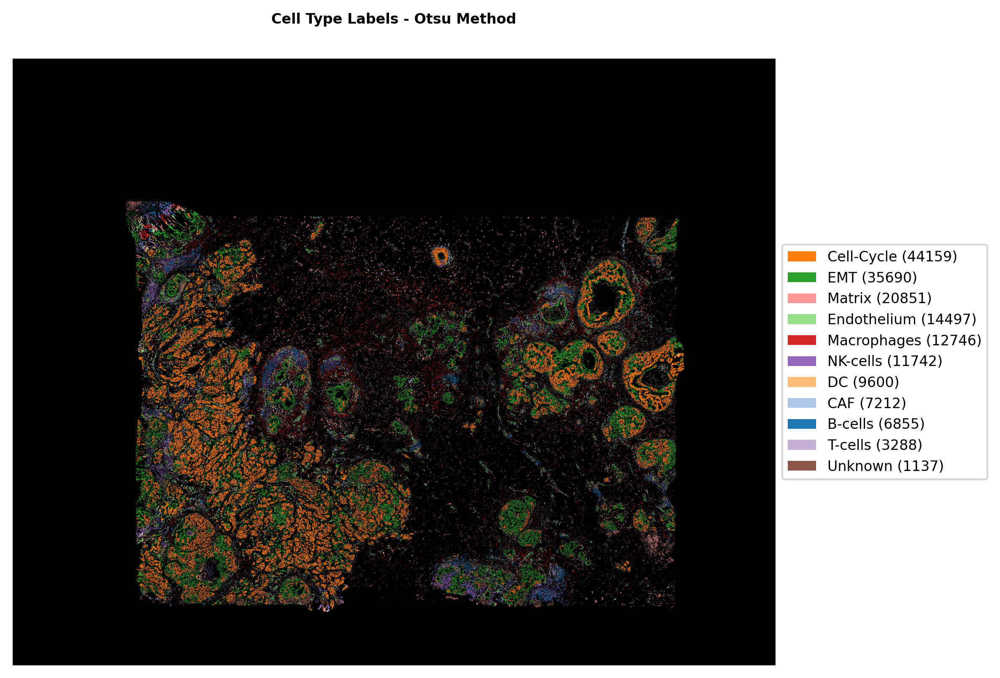


Creating zoomed-in view of a representative region...
Saved zoomed visualization to: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels/otsu_cell_labels_zoom.png


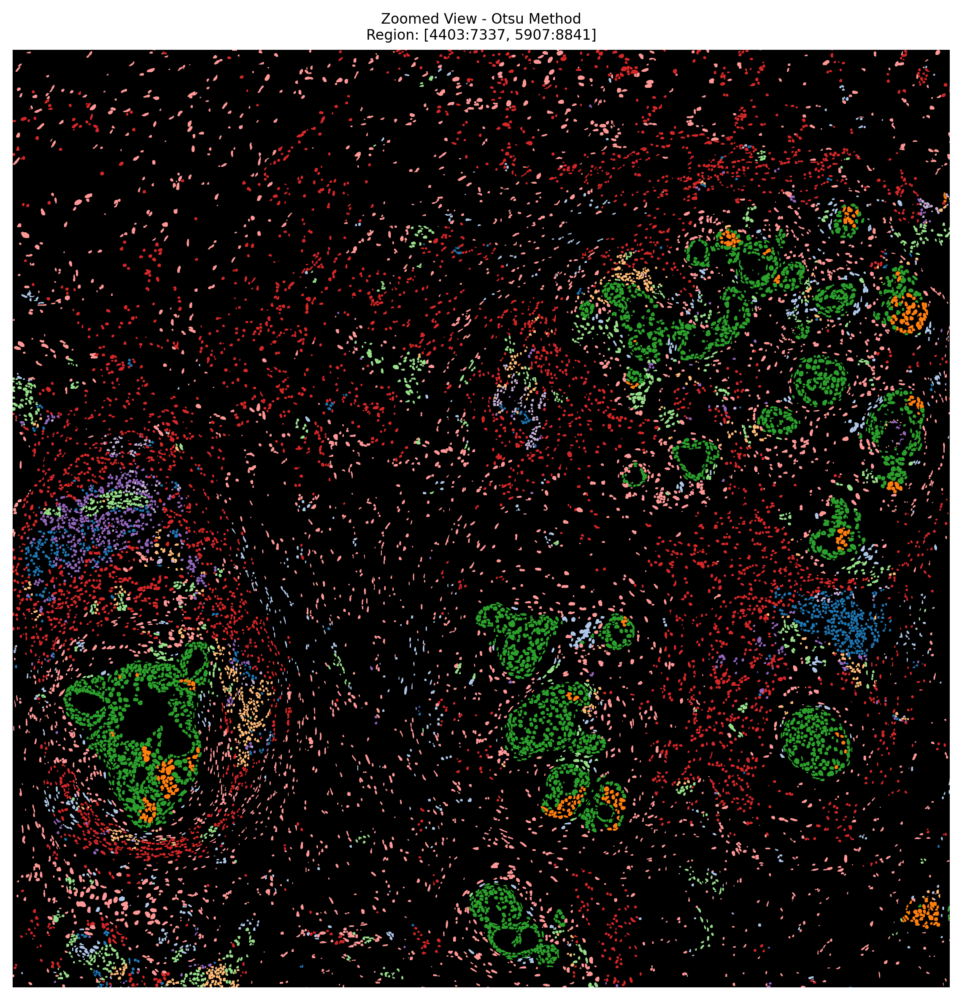

Saved label visualization to: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels/otsu_cell_labels.png

✓ Cell label visualization saved to:
  /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels


In [ ]:
# Create spatial visualization of cell labels
label_dir = os.path.join(output_dir, 'cell_labels')
os.makedirs(label_dir, exist_ok=True)
first_pathway = list(pathway_arrays.keys())[0]
array_shape = pathway_arrays[first_pathway].shape

# Visualize Otsu method labels
visualize_cell_labels(
    cell_scores=labeled_scores_otsu,
    method='otsu',
    output_dir=label_dir,
    array_shape=array_shape,
    downsample_size=downsample_size,
    min_x=min_x,
    min_y=min_y,
    blank=blank,
    figsize=8,
    cells=cells
)

print(f"\n✓ Cell label visualization saved to:\n  {label_dir}")

#### 3.5 Save labeled results

Save the cell type assignments for downstream analysis.

In [ ]:
# Save labeled scores to CSV
csv_path_dominant = os.path.join(label_dir, f'cell_labels_dominant.csv')
csv_path_otsu = os.path.join(label_dir, f'cell_labels_otsu.csv')

labeled_scores_dominant.to_csv(csv_path_dominant, index=False)
labeled_scores_otsu.to_csv(csv_path_otsu, index=False)

print(f"✓ Labeled cell scores saved:")
print(f"  - Dominant method: {csv_path_dominant}")
print(f"  - Otsu method: {csv_path_otsu}")

✓ Labeled cell scores saved:
  - Dominant method: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels/cell_labels_dominant.csv
  - Otsu method: /workspace/results/NCBI785/analysis_cell_scoring/NCBI785/cell_labels/cell_labels_otsu.csv


### 4. Summary

In this notebook, we demonstrated how to:

1. **Load cell segmentation** from GeoJSON files (from CellViT, Hovernet, or Xenium)
2. **Load PASTA predictions** from NPZ files generated during inference
3. **Aggregate pixel-level predictions to cell level** by calculating mean scores within cell boundaries
4. **Assign cell type labels** using multiple methods (Dominant, Otsu, K-means, etc.)
5. **Visualize and save results** in multiple formats (CSV, H5AD, spatial plots)
